# Using K-means for color compression 


## Modeling objective
- Use K-means to cluster the pixels of a photograph based on their encoded color values. 
- Explore how different values of _k_ affect the clustering of the pixels, and thus the appearance of the photograph. 
- Evaluate the results of the K-means clustering using the elbow method and silhouette scores.
- Also explore a bit about density-based spatial clustering (DBSCAN) and agglomerative clustering.

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%pylab inline 
import plotly.graph_objects as go  # for 3_D visulization

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


(420, 300, 3)


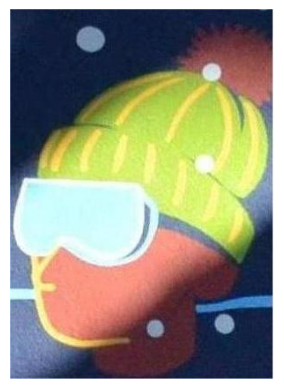

In [4]:
# Read in a photo
img = plt.imread('Granville Island.jpg')

# Display the photo and its shape
print(img.shape)
plt.imshow(img)
plt.axis('off');

Here is a photograph of graffuti from Graville Island. The shape of the image is 456 x 350 x 3. This can be interpreted as pixel data and this photograph has 456 vertical pixels and 350 horizontal pixels. 

The third dimension of '3' indicates the values that encode the color of every pixel. Every pixel has 3 parameters: red (R), green (G), and blue (B), also known as its RGB values. The encoded value for each of these colors—R, G, and B—can vary from 0 to 255. Consequently, there are 256³, which equals 16,777,216 distinct RGB combinations, each yielding a unique color display on your screen.

To prepare this data for modeling, I'll reshape it into an array, where each row represents a single pixel's RGB color values. 

In [5]:
# Reshape the image so that each row represents a single pixel 
# defined by three values: R, G, B
img_flat = img.reshape(img.shape[0]*img.shape[1], 3)

print('First five rows for array of pixels: \n', img_flat[:5, :])
print('Shape of the array:', img_flat.shape)

First five rows for array of pixels: 
 [[111 124 156]
 [ 68  81 113]
 [ 72  85 117]
 [ 82  95 127]
 [ 80  93 125]]
Shape of the array: (126000, 3)


## Plot the data in 3-D space
There are 159600 pixels in the image and each of them has 3 features (RGB). Because we have only 3 features, we can plot the data in 3-D space to see if there are any clusters.

In [6]:
# Create a pandas df with r, g, and b as columns
img_flat_df = pd.DataFrame(img_flat, columns = ['r', 'g', 'b'])
img_flat_df.head()

,r,g,b
0,111,124,156
1,68,81,113
2,72,85,117
3,82,95,127
4,80,93,125


In [7]:
# Create 3D plot where each pixel in the `img` is displayed in its actual color
trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=['rgb({},{},{})'.format(r,g,b) for r,g,b 
                                        in zip(img_flat_df.r.values, 
                                               img_flat_df.g.values, 
                                               img_flat_df.b.values)],
                                 opacity=0.5))

data = [trace]

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0),
                               )

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene = dict(
                    xaxis_title='R',
                    yaxis_title='G',
                    zaxis_title='B'),
                  )
fig.show()

This is an interactive plot. You can click, zoom, pan and rotate the plot.
In this plot, each dot represent a pixel in the image. The more intense the color, the more dots there are in that area. The most-represented colors in the graph are the most common colors in the image, which are blues, greens, reds and yellows.
Let's build a K-means model with 3 clusters and see what colors we get.

## Cluster the data: _k_ = 3

In [8]:
# Instantiate the model
kmeans = KMeans(n_clusters=3, random_state=777).fit(img_flat)

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



#### Check the color of the three centroida

In [9]:
# Assign centroid coordinates to `centers` variable
centers = kmeans.cluster_centers_
centers

array([[219.00797633, 249.29454522, 243.94751061],
       [ 43.93052694,  42.61976354,  64.40911706],
       [195.90045425, 184.00860774, 118.7696944 ]])

In [10]:
# Helper function that creates color swatches
def show_swatch(RGB_value):
    '''
    Takes in an RGB value and outputs a color swatch
    '''
    R, G, B = RGB_value
    rgb = [[np.array([R,G,B]).astype('uint8')]]
    plt.figure(figsize=(1.2,1.2))
    plt.imshow(rgb)
    plt.axis('off');

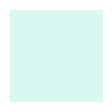

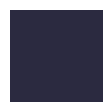

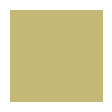

In [11]:
# Display the color swatches
for pixel in centers:
    show_swatch(pixel)

### Generate the image when k=3

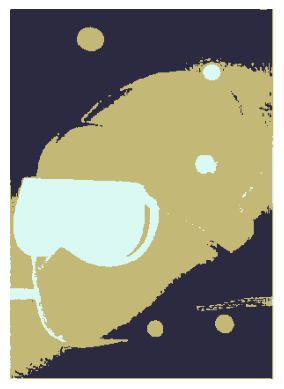

In [12]:
# Copy `img_flat` so we can modify it
img_flat1 = img_flat.copy()

# Replace each row in the original image with its closest cluster center
for i in np.unique(kmeans.labels_):
    img_flat1[kmeans.labels_==i,:] = kmeans.cluster_centers_[i]

# Reshape the data back to (456, 350, 3)
img1 = img_flat1.reshape(img.shape)

plt.imshow(img1)
plt.axis('off');

In [13]:
# Create a new column in the df that indicates the cluster number of each row 
# (as assigned by Kmeans for k=3)
img_flat_df['cluster'] = kmeans.labels_
img_flat_df.head()

,r,g,b,cluster
0,111,124,156,2
1,68,81,113,1
2,72,85,117,1
3,82,95,127,1
4,80,93,125,1


In [14]:
# Create helper dictionary to map RGB color values to each observation in df
series_conversion = {0: 'rgb' +str(tuple(kmeans.cluster_centers_[0])),
                     1: 'rgb' +str(tuple(kmeans.cluster_centers_[1])),
                     2: 'rgb' +str(tuple(kmeans.cluster_centers_[2])),
                     }
series_conversion

{0: 'rgb(219.0079763283116, 249.29454522063918, 243.94751061366458)',
 1: 'rgb(43.930526940995236, 42.6197635354588, 64.40911706293821)',
 2: 'rgb(195.90045424818834, 184.0086077381273, 118.76969439878313)'}

In [15]:
# Replace the cluster numbers in the 'cluster' col with formatted RGB values 
# (made ready for plotting)
img_flat_df['cluster'] = img_flat_df['cluster'].map(series_conversion)
img_flat_df.head()

,r,g,b,cluster
0,111,124,156,"rgb(195.90045424818834, 184.0086077381273, 118..."
1,68,81,113,"rgb(43.930526940995236, 42.6197635354588, 64.4..."
2,72,85,117,"rgb(43.930526940995236, 42.6197635354588, 64.4..."
3,82,95,127,"rgb(43.930526940995236, 42.6197635354588, 64.4..."
4,80,93,125,"rgb(43.930526940995236, 42.6197635354588, 64.4..."


In [16]:
# Replot the data, now showing which cluster (i.e., color) it was assigned to by K-means when k=3

trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=img_flat_df.cluster,
                                 opacity=1))

data = trace

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0))

fig = go.Figure(data=data, layout=layout)
fig.show()

You would have noticed that in the original 3D plot, there are long bands of clusterd data and the K-means clusters are really boxy. <br/>**K-means works best when the clusters are more circular because it is based on minimizing the distance from the centroid.**

**DBSCAN is a clustering algorithm that is based on the idea that clusters are dense groups of points. Instead of trying to minimize the distance from the centroid, it searches for areas where the density of the data points is higher.**

**On the other hand, agglomerative clustering works by starting with each data point as a cluster and then merging clusters based on intercluster distance.**

## Cluster the data: _k_ = 2-6 clusters
### Due to the limitation of the file size that can be uploaded to GitHub.

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change fro

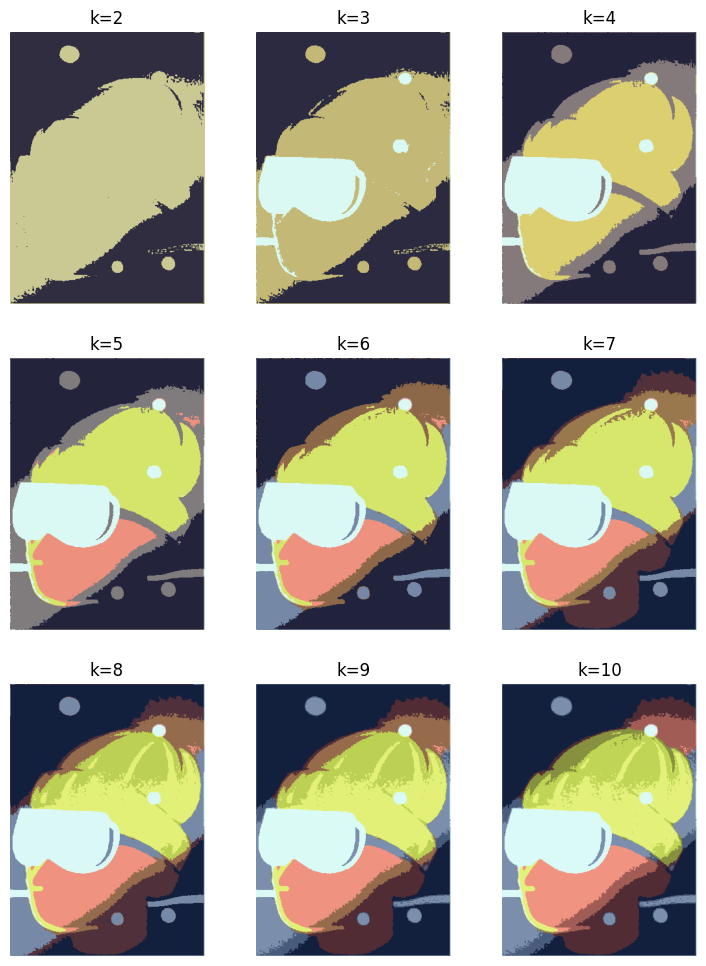

In [18]:
# Helper function to plot image grid
def cluster_image_grid(k, ax, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image on an axis of a figure.

    Args:
      k:    (int)          - Your selected K-value
      ax:   (int)          - Index of the axis of the figure to plot to
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      A new image where each row of img's array has been replaced with the \ 
      coordinates of its nearest centroid. Image is assigned to an axis that \
      can be used in an image grid figure.
    '''
    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters=k, random_state=42).fit(img_flat)
    new_img = img_flat.copy()

    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_==i, :] = kmeans.cluster_centers_[i]

    new_img = new_img.reshape(img.shape)
    ax.imshow(new_img)
    ax.axis('off')

fig, axs = plt.subplots(3, 3)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 12)
axs = axs.flatten()
k_values = np.arange(2, 11)
for i, k in enumerate(k_values):
    cluster_image_grid(k, axs[i], img=img)
    axs[i].title.set_text('k=' + str(k))

From the nine generated images above,  it becomes increasingly difficult to see the difference between the images each time a color is added. This is a visual example of something that happens with all clustering models, even if the data is not an image that you can see. As you group the data into more and more clusters, additional clusters beyond a certain point contribute less and less to your understanding of your data.

Additionnaly, we can use evaluation method such as the elbow method and silhouette scores to find the optimal number of clusters.

## Evaluation of K-means models

In [ ]:
# Fit K-means and evaluate inertia for different values of k.
num_clusters = [i for i in range(2,11)]

def kmeans_inertia(num_clusters,x_vals):
    inertia = []
    for num in num_clusters:
        kms = KMeans(n_clusters=num, random_state=42)
        kms.fit(x_vals)
        inertia.append(kms.inertia_)
    return inertia

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\JY\.ipython\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change fro

Text(0, 0.5, 'Inertia')

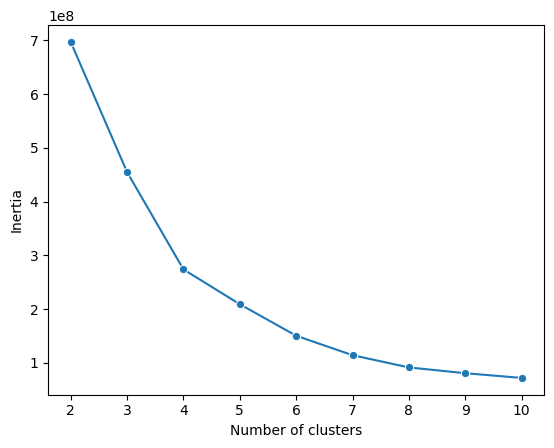

In [ ]:
inertia = kmeans_inertia(num_clusters, img_flat)

# Create a line plot.
sns.lineplot(x=num_clusters, y=inertia, marker = 'o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

There is no obvious elbow in this plot, so the silhouette score would be a great choice to determine the optimal number of clusters.
<br />
**In this case, however, due to the facte that it's for color compression and the limit of computing power, the plot of silhouette scores would not be calculated and plotted. Additionally, the optimal number of clusters always depends on the context of the business problem nd the goal of the analysis.**